# Assignment 4 : Reinforcement Learning

# Name : Rohit Shenvi Diwadkar

# Overview

__This assignment is about playing blackjack by using Reinforcement learning. The objective of this assignment is to train the agent and make the machine to learn how to play and win blackjack.__

__We use two class along with concept using TD-learning for the above objective.__


# Problem

## Blackjack

<img src="https://upload.wikimedia.org/wikipedia/commons/a/a2/Blackjack_game_1.JPG" width=800 />
 
Now, we play Blackjack! 
 We have improved version of it from OpenAI Gym [Blackjack-V0](https://gym.openai.com/envs/Blackjack-v0/). Our blackjack has an additional betting option. Here follows the rule description. 

 
 ### <font color="red"> Game Introduction and Rules: </font>
 
 
 Blackjack is a card game where the goal is to obtain cards that sum to as
 near as possible to 21 without going over.  They're playing against a fixed
 dealer.
 
 Face cards (Jack, Queen, King) have point value 10.
 Aces can either count as 11 or 1, and it's called 'usable' at 11.
 This game is placed with an infinite deck (or with replacement).
 
 The game starts with each player getting two face up cards and dealer
 having one face up and face down card and the player needs to bet an 
 amount of money within range of 1 to max bet (10). 
 Note: Face up means that you will know what the card is.
 
 The player can request additional cards (hit=1) until they decide to stop
 (stick=0) or exceed 21 (bust).
 
 After the player sticks, the dealer reveals their facedown card, and draws
 until their sum is 17 or greater (fixed policy).  If the dealer goes bust the player wins.
 You won't see the dealer's facedown card, just you will know if you have or lost
 and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match
 is drawn.
 (It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)
 
 If the player wins, the amount he has bet will be doubled and given back. 
 If the player and dealer have the same sum, then its a draw and the player will get
 back the money he has bet. 
 If the player loses then, the money he bet will be lost. 
 If neither player nor dealer busts, the outcome (win, lose, draw) is
 decided by whose sum is closer to 21. You are free to change the reward function to make it 
 learn more efficiently. (i.e.,  the amount of money the user is winning after each round). 
 
 Regardless of the number of players on the table, each player will be just playing against the 
 dealer independently of the other players.


## Blackjack Environment

In [233]:
import collections
import numpy as np
import matplotlib.pyplot as plt
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline

### Player class definition
Player class defines an object for each BlackJack player with a given unique name. It has three attributes, the player's name, current cards in hand, and total balance left to play games. get_info() is getter method that prints out all three attributes.

In [234]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))    

__Following functions are utilities and definition of card deck to play games and to check the game status.__

In [235]:
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)

def draw_card(np_random):
    return int(np_random.choice(deck))

def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]

These are important member functions used by me:

* add_player: Used to add your player object with some initial amount of money

* step: Used to send the action using this function, actions are hit(1) or stand(0)

 returns {'state': player info and dealer info (_get_obs), 
          'reward': real-valued reward, 
          'is_round_done': True/Fasle}
* _get_obs: returns the state of the env or required information you can use to build your agent.
      eg: {'player_info':{'player_sum_card': sum of cards, 
                          'player_card': list of cards, 
                          'player_total_balance': real-valued number, 
                          'usable_ace' : True/False}, 
          'dealer_info': dealer's first card}
* init_round: will start a new round in the same game.

 returns {'state': player info and dealer info (_get_obs)}
* reset: will reset the whole game and you will being again with the initial balance you had started the player object.

 returns nothing, will just reset the entire game.
* bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10.

 returns nothing.

In [236]:
class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
            
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            print("player loser, wont get back the money, try next round")
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}

In [237]:
from collections import defaultdict

# Methods

Temporal difference (TD) learning confirms that the agent knows some parts of information of the Decision Processes. Current and next state transition and without any model transition probability, TD lets the agent explore the environment to examine the random policy.

SARSA and Q-Learning :

SARSA --
SARSA( State action reward state action ) is an algorithm for learning a Markov process which are being used in RL or machine learning.
![alt](http://incompleteideas.net/book/ebook/pseudotmp8.png)

Q-Learning --

Q-learning is an algorithm for learning decision policy process that predicts what action to take under what situation. It does not require a model of the environment, and it can handle problems with stochastic transitions and rewards.

![alt](http://incompleteideas.net/book/ebook/pseudotmp9.png)



__I will go with Q-learning for my RL agent. In this approach we first learn to the Q-value for each action and state.
After that we set all the Q value . Once, the action has been applied to a state we check the state that is if the state has an desirable output we will take maximum of the Q value of that action and so that this action is selected next time  Similarly, if we receive a reward for that action then we will consider the Q value of that action so that it is more likely that, that action is selected next time.__

__In Q-learning the agent learns in initial state 1, performs action 1 and gets a reward 1 then looks and sees what the maximum possible reward for an action is in state 2, and uses that to update the action value of performing action 1 in state 1.__

__Hence, In Q-learning it is the highest possible action that can be taken from state 2 which is an optimal policy to be followed. That's why I selected Q-learning.__ __So we choose (np.max(self.Q[new_state]) as a function approximation for more optimal and accurate policy process application.__

### RL Agent:

1.  __init__: used for initializing the agent and the Q values for each state and action to 0.
2.  greedy : used for selecting q-values of a state.
2.  epsilon_greed: used for selecting the greedy move based on the Q-values of a given state 's'. 
3.  train: used for training the Q values for the environment based on Q-learning rules.
4.  test: used for executing the agent(which we have trained) on the given environment.

In [250]:
class RLagent: 
   
    def __init__(self, env):
        self.env = env
        self.n_a = env.action_space.n 
        self.Q = defaultdict(np.zeros(self.n_a)) 
     
    def greedy(self, Q, state):
        return np.argmax(self.Q[state]) 
    
    def epsilon_greed(self, epsilon, state):
        if np.random.rand() < epsilon:
            return np.random.randint(self.n_a)
        else:
            return self.greedy(self.Q, state)
        
    def main_item(self,state):
        state = (state['player_info']['player_sum_card'], state['dealer_info'],state['player_info']['usable_ace'])
        return state
    
    def train(self,player1, **params):
        # parameters
        
        gamma = params.pop('gamma', 0.99) # discounting factor
        alpha = params.pop('alpha', 0.1) # learing rate
        epsilon= params.pop('epsilon', 0.1) # greedy choice
        maxiter= params.pop('maxiter', 1000) # maximum number of times we run the experiment
        rewards = []  #rewards
        #busts = []
        win = 0
        loss = 0
        draw = 0
        rtrace = []
        number_of_games = 100
        number_of_rounds = 1000
        
        for i in range(maxiter):
            self.env.reset() 
            finished = False
            print("-"* 50)
            print("Game Number: {}".format(i + 1))
            print("-"* 50)
           
            counts = 0
            trace = []
            

            for step in range(number_of_rounds):
                 
                    print("%"* 50)
                    print("Game Number: {} Round Number: {}".format(j+1, step+1))
                    print("%"* 50)

                    #Check if you have enough money left in the account to bet, if not break and start a new game
                    valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
                    if valid_bet_flag['is_round_done']:
                        print("You are out of money ! Will go to next game !!")
                        break
                    bet_amount = valid_bet_flag['valid_bet_amount']

                    #Get the observations i.e state and use it to decide how much you want to bet
                    state = env.init_round(player1.player_name)
                    print(state)
                    print("Initial state: {}".format(state))
                    state = self.main_item(state['state'])
                    #print (state['state'])
                    # If you have just $1 left in the bank, you have no choice but to bet that amount 
                    # and hopefully leave it to the fate for your agent to win and continue playing or just
                    # start a new game
                    if len(bet_amount) == 1 and bet_amount[0] == 1:
                        print("You can only bet 1. So betting only 1.")
                        random_bet = 1
                    else:
                        random_bet = np.random.choice(bet_amount)
                        print(counts)
                    print("Random Init Bet: {}".format(random_bet))
                    env.bet_money(player1.player_name, random_bet)
                    action = self.epsilon_greed(epsilon, state)
                    finished = False
                    while True:
                        
                        rel = env.step(player1.player_name,action)
                        new_state, reward, done = rel['state'], rel['reward'], rel['is_round_done']
                        new_state = self.main_item(new_state)
                       #print("State after nth action: {}".format(new_state))
                        new_action = self.epsilon_greed(epsilon, new_state)
                       #print("Action taken: {}".format(new_action))
                        trace.append(new_state)
                        rewards.append(reward)

                        #print(a)
                        
                        # Update self.Q table
                        self.Q[state][action] = self.Q[state][action] + (alpha * ((reward + (gamma * np.max(self.Q[new_state])))))
                        state = new_state
                        action = new_action
                        counts = counts + 1
                       #print("Balance Left: {}".format(round_obs['state']['player_info']['player_total_balance']))
                       #print("Round over")
                       #print("-%-"*30)
                       #if (step + 1) == (number_of_rounds):
                        #   print("Max number of rounds played. If you see this message, you are the winner.")
                        
                        if done:
                            break
                        
                        
            rtrace.append(np.sum(rewards))
    
        return rtrace, trace

    def test(self,player1,maxiter=1000):
        epsilon = 0
        win = 0
        loss = 0
        draw = 0
        rtrace = []
        trace = []
        actions = []
        counts = 0
        for j in range(maxiter):
            self.env.reset()
            valid_bet_flag = env.get_valid_bet_amount(player1.player_name)
            if valid_bet_flag['is_round_done']:
                #rint("You are out of money ! Will go to next game !!")
                break
            bet_amount = valid_bet_flag['valid_bet_amount']

            #Get the observations i.e state and use it to decide how much you want to bet
            state = env.init_round(player1.player_name)
            #rint(state)
            #rint("Initial state: {}".format(state))
            state = self.main_item(state['state'])
            #print (state['state'])
            # If you have just $1 left in the bank, you have no choice but to bet that amount 
            # and hopefully leave it to the fate for your agent to win and continue playing or just
            # start a new game
            if len(bet_amount) == 1 and bet_amount[0] == 1:
               #print("You can only bet 1. So betting only 1.")
                random_bet = 1
            else:
                random_bet = np.random.choice(bet_amount)
           #print("Random Init Bet: {}".format(random_bet))
            env.bet_money(player1.player_name, random_bet)
            action = self.epsilon_greed(epsilon, state)
            finished = False
            while True:
                # Get current observation
                rel = env.step(player1.player_name,action)
                new_state, reward, done = rel['state'], rel['reward'], rel['is_round_done']
                new_state = self.main_item(new_state)

                new_action = self.epsilon_greed(epsilon, new_state)
                trace.append(new_state)
                rewards.append(reward)
                        
                state = new_state
                action = new_action
                counts = counts + 1
                        
                if reward > 0:
                    win += 1
                elif reward < 0:
                    draw += 1
                else:
                    loss += 1
                            
                if done:
                    break
            rtrace.append(np.sum(rewards))
        win = (win*100)/counts
        loss = (draw*100)/counts
        draw = (loss*100)/counts
        print('Win =' + str(win) + '%')
        print('Draw =' + str(draw)+ '%')
        print('Loss =' + str(loss) + '%')
        return rtrace, trace

# Results


__Below is the implemetation of training the agent and test it for better wining possibility.__

In [251]:
env = BlackjackEnv()

agent = RLBlackJack(env)
player1 = Player('player1')
env.add_player(player1)
rtrace, trace = agent.train(player1)



--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Initial state: {'state': {'player_info': {'player_sum_card': 4, 'player_card': [2, 2], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}}
Random Init Bet: 5
player loser, wont get back the money, try next round
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 5
{'state': {'player_info': {'player_sum_card': 18, 'player_card': [10, 8], 'player_total_balance': 5, 'usable_ace': False}, 'dealer_info': 6}}
Initial state: {'state': {'playe

## NOTE: Please scroll down the test part to see the Win and lose %

In [252]:
rtrace, trace = agent.test(player1)

player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [2, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 9}}
Random Init Bet: 7
player loser, wont get back the money, try next round
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 4}}
Initial state: {'state': {'player_info': {'player_sum_card': 13, 'player_card': [3, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 4}}
Random Init Bet: 10
player loser, wont get back the money, try next round
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 10, 'player_card': [7, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
Initi

__We can see that the above agent is working fine and giving win% in the range 17 - 23 % which is still low and have to improve so to improve we can play with the selection of parameters.__

Text(0, 0.5, 'sum of rewards')

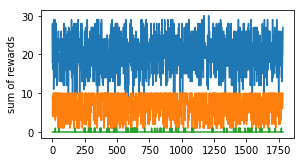

In [253]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(321)
    # plot rewards 
plt.plot(rtrace)
plt.ylabel("sum of rewards")

__The Sum of rewards shows that as the iterations increase the agent learns the best moves to reach the goal location.__

## Parameter Selection

### Gamma
Here we are going for check for gamma (discounting factor by reducing its value)

In [254]:
agent = RLBlackJack(env)
maxiter = 1000
rtrace,trace = agent.train(player1,gamma=0.001, 
                            alpha=0.1, 
                            epsilon=0.1, 
                            maxiter=maxiter)

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [7, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
Random Init Bet: 7
player winner
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 17
{'state': {'player_info': {'player_sum_card': 7, 'player_card': [3, 4], 'player_total_balance': 17, 'usable_ace': False}, 'dealer_info': 4}}
Initial state: {'state': {'player_info': {'player_sum_card': 7, 'player_

## NOTE: Please scroll down the test part to see the Win and lose %

In [255]:
rtrace, trace = agent.test(player1)

player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 8}}
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 8}}
Random Init Bet: 7
player loser, wont get back the money, try next round
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Initial state: {'state': {'player_info': {'player_sum_card': 18, 'player_card': [8, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Random Init Bet: 8
player winner
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 15, 'player_card': [8, 7], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
Initial state: {'state': {'player_info': {'p

Text(0, 0.5, 'sum of rewards')

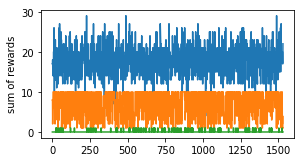

In [256]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(321)
    # plot rewards 
plt.plot(rtrace)
plt.ylabel("sum of rewards")

__We can see that if we take lower value of $\gamma$  the agent takes current rewards. Therefore, it is better to have higher $\gamma$ value.__

### Alpha 

Here we are going for check for $\alpha$ (learning rate by increasing its value)

In [257]:
agent = RLBlackJack(env)
maxiter = 1000
rtrace,trace = agent.train(player1,gamma=0.99, 
                            alpha=0.999, 
                            epsilon=0.1, 
                            maxiter=maxiter)

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
Initial state: {'state': {'player_info': {'player_sum_card': 9, 'player_card': [4, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 5}}
Random Init Bet: 7
player loser, wont get back the money, try next round
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 3
{'state': {'player_info': {'player_sum_card': 13, 'player_card': [4, 9], 'player_total_balance': 3, 'usable_ace': False}, 'dealer_info': 2}}
Initial state: {'state': {'player_i

## NOTE: Please scroll down the test part to see the Win and lose %

In [258]:
rtrace, trace = agent.test(player1)

player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 9}}
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [3, 1], 'player_total_balance': 10, 'usable_ace': True}, 'dealer_info': 9}}
Random Init Bet: 5
player winner
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
Initial state: {'state': {'player_info': {'player_sum_card': 10, 'player_card': [5, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 6}}
Random Init Bet: 10
Draw match
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 1}}
Initial state: {'state': {'player_info': {'player_sum_card': 14, 'player_card': [4, 10], 

Text(0, 0.5, 'sum of rewards')

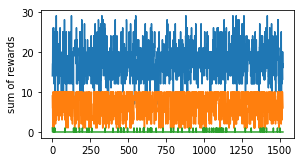

In [259]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(321)
    # plot rewards 
plt.plot(rtrace)
plt.ylabel("sum of rewards")

__As we can see that it increases the win % so it is better to have value closer to one__

### Epsilon

Here we are going for $\epsilon$ by  Increasing  the value

In [260]:
agent = RLBlackJack(env)
maxiter = 1000
rtrace,trace = agent.train(player1,gamma=0.99, 
                            alpha=0.1, 
                            epsilon=0.99, 
                            maxiter=maxiter)

--------------------------------------------------
Game Number: 1
--------------------------------------------------
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 1
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Initial state: {'state': {'player_info': {'player_sum_card': 19, 'player_card': [10, 9], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 2}}
Random Init Bet: 4
player loser, wont get back the money, try next round
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
Game Number: 1 Round Number: 2
%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%
player name: player1 money left: 6
{'state': {'player_info': {'player_sum_card': 9, 'player_card': [3, 6], 'player_total_balance': 6, 'usable_ace': False}, 'dealer_info': 10}}
Initial state: {'state': {'play

## NOTE: Please scroll down the test part to see the Win and lose %

In [261]:
rtrace, trace = agent.test(player1)

player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
Initial state: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 10], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
Random Init Bet: 9
player winner
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
Initial state: {'state': {'player_info': {'player_sum_card': 12, 'player_card': [8, 4], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 3}}
Random Init Bet: 2
player loser, wont get back the money, try next round
player name: player1 money left: 10
{'state': {'player_info': {'player_sum_card': 15, 'player_card': [7, 8], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}}
Initial state: {'state': {'player_info': {

Text(0, 0.5, 'sum of rewards')

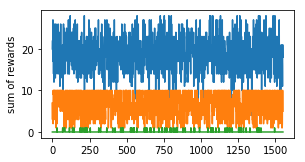

In [262]:
fig = plt.figure(figsize=(10,8))
ax = fig.add_subplot(321)
    # plot rewards 
plt.plot(rtrace)
plt.ylabel("sum of rewards")

__As we can see that the win % is decreasing which means that the agent would want to make a greedy choice that it it would want to go closer to 21. Therefore, it is better to have $\epsilon$ value lower.__

# Conclusion




__Reinforcement Learning is very important part of machine learning which specially used in software agents and machines are made to ascertain the ideal behavior in a specific context with the aim of maximizing its performance.__

From this assignments I learned alot and faced lot of challenges:

1. First the random betting confused alot to which there was some errors arised while designing RL agent.Lot of print statement where making system slow.

2. It was very difficult to return some of the data from the agent which made difficult to plot it.

3. I learned alot about RL through this assignment and about correct parameter selecction by experimenting the values.

4. Also learned about the TD learning and choosing perfect agent for particular usecase.